In [1]:
import numpy as np
import pandas as pd
import datetime as dt
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import mean_squared_error

import os

from pandas.plotting import register_matplotlib_converters
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
font_path = '/Library/Fonts/NanumGothic.ttf'
font_name = fm.FontProperties(fname=font_path, size=10).get_name()
plt.rc('font', family=font_name, size=12)
plt.rcParams["figure.figsize"] = (30, 10)
register_matplotlib_converters()

In [2]:
plt.style.use('ggplot')
mpl.font_manager._rebuild()
mpl.pyplot.rc('font', family='NanumGothic')

In [3]:
# 소비자물가지수
consumer = pd.read_excel('/Users/minki/pythonworkspace/bigcon2020/2020dataset/counsumer_index.xlsx')

In [4]:
# 온라인쇼핑몰 운영형태
online_shop = pd.read_excel('/Users/minki/pythonworkspace/bigcon2020/2020dataset/온라인쇼핑몰_운영형태_상품군별거래액.xlsx')

In [5]:
# cj 물류 데이터
cj_shop = pd.read_excel('/Users/minki/pythonworkspace/bigcon2020/2020dataset/CJ_data/CJ_data.xlsx')

In [6]:
# gs 유통 데이터
gs_category = pd.read_excel("/Users/minki/pythonworkspace/bigcon2020/2020dataset/GS_data/04_혁신아이디어분야_유통데이터(GS리테일)_데이터정의서 및 문제 데이터.xlsx", sheet_name='카테고리별 매출비중')
gs_dong = pd.read_excel("/Users/minki/pythonworkspace/bigcon2020/2020dataset/GS_data/04_혁신아이디어분야_유통데이터(GS리테일)_데이터정의서 및 문제 데이터.xlsx", sheet_name='동별매출지수', header=[3])
gs_total = pd.read_excel("/Users/minki/pythonworkspace/bigcon2020/2020dataset/GS_data/04_혁신아이디어분야_유통데이터(GS리테일)_데이터정의서 및 문제 데이터.xlsx", sheet_name='종합테이블(TB_DD_STR_PURCH_CLS)')

In [7]:
# 신한카드 데이터
resident = pd.read_csv('/Users/minki/pythonworkspace/bigcon2020/csv_files/카드_내국인.csv', encoding = 'utf-8')
foreigner = pd.read_csv('/Users/minki/pythonworkspace/bigcon2020/csv_files/카드_외국인.csv', encoding = 'utf-8')

# 1. 소비자 물가지수에 따른 소비 패턴 변화 파악

In [8]:
consumer_2019 = consumer.iloc[:, :14]
consumer_2020 = consumer.iloc[:, [0, 1, 14, 15, 16, 17, 18, 19, 20]]

In [9]:
consumer_index = list(consumer_2019.지수코드별.value_counts().index)

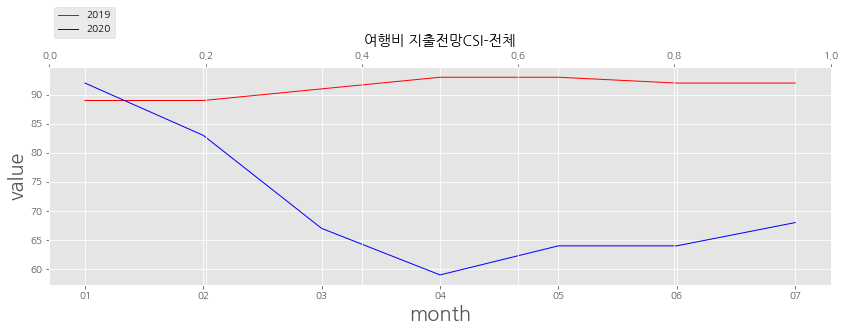

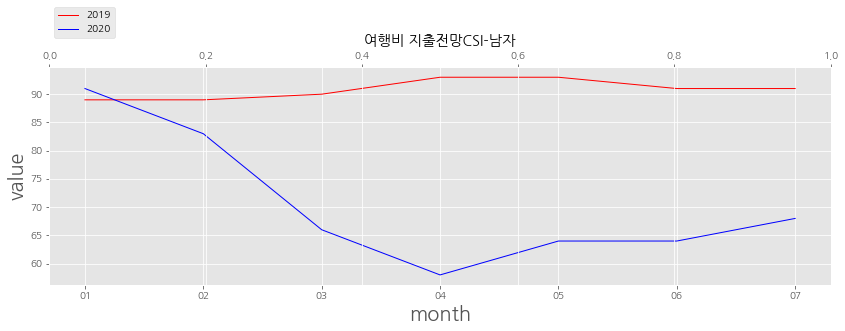

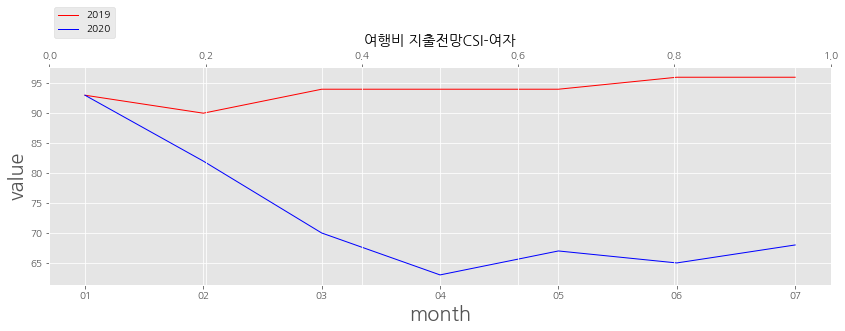

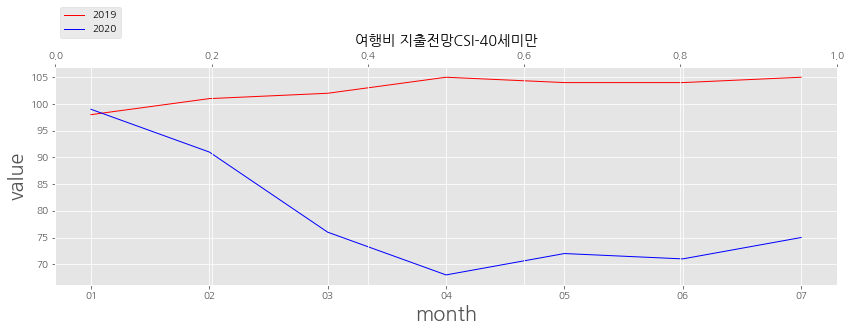

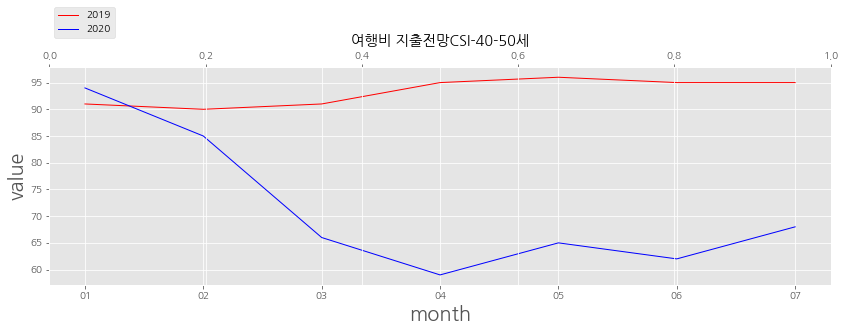

...

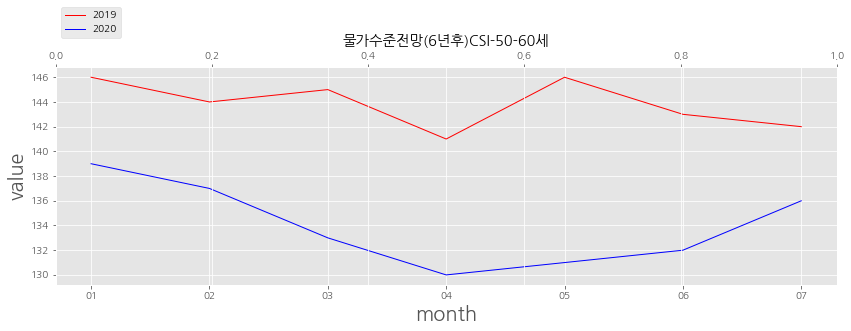

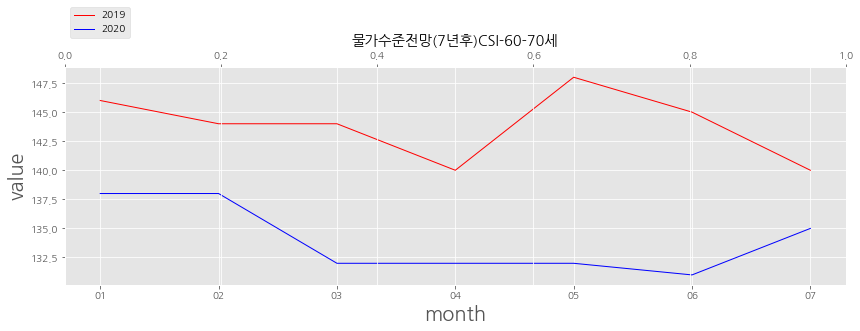

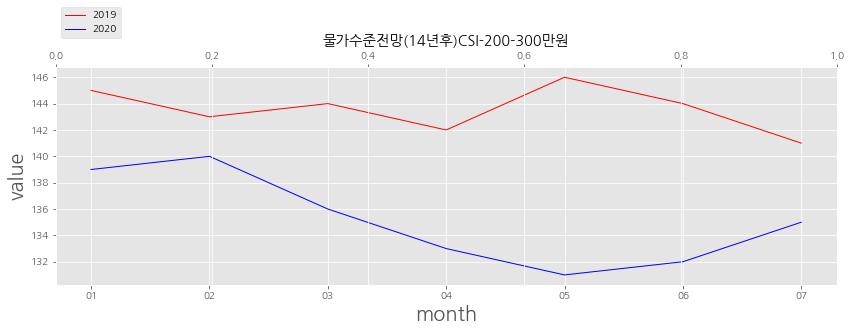

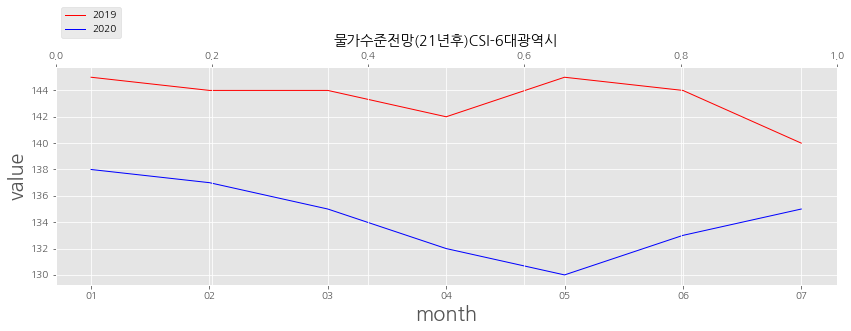

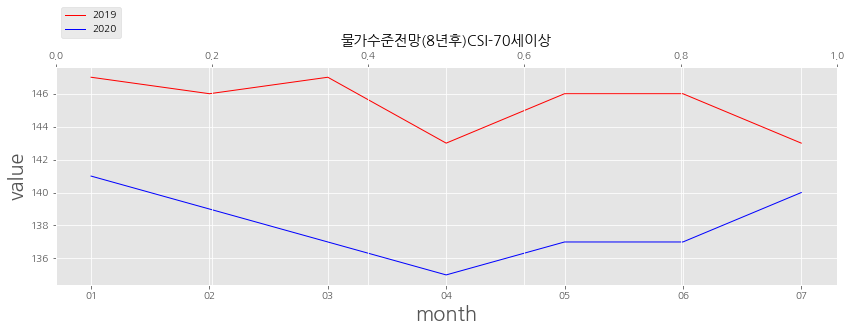

In [10]:
days = ['01' ,'02', '03', '04', '05', '06', '07']

for index in consumer_index:
    
    name = index.replace('\u3000', '')
    
    # 2019 consumer data preprocess
    sample = consumer_2019[consumer_2019.지수코드별 == index].iloc[:, 1:].T
    sample = sample.rename(columns = sample.iloc[0])
    sample = sample.drop(sample.index[0])
    sample = sample.iloc[:7, :]
    
    # 2020 consumer data preprocess
    sample2 = consumer_2020[consumer_2020.지수코드별 == index].iloc[:, 1:].T
    sample2 = sample2.rename(columns = sample2.iloc[0])
    sample2 = sample2.drop(sample2.index[0])
    
    for idx in range(0, len(list(sample.columns))):
        
        sub_name = list(sample.columns)[idx].replace('\u3000', '')
        
        data = sample.iloc[:, idx].astype(float)
        data2 = sample2.iloc[:, idx].astype(float)
        
        fig, ax = plt.subplots(figsize=(14,4))
        sns.lineplot(x = data.reset_index(drop=True).index, y = data.values, color = 'red', 
                     label = '2019', ax = ax, linewidth = 1)
        
        g = ax.twiny()
        g = sns.lineplot(x = data2.reset_index(drop=True).index, y = data2.values, color = 'blue', 
                         label = '2020', ax = ax, linewidth = 1)

        g.set_xticks(range(len(days)))
        g.set_xticklabels(days)

        ax.set_title(f'{name}-{sub_name}')
        ax.legend(loc='upper left', bbox_to_anchor=(0, 1.3))
        ax.set_xlabel('month',fontsize=20);
        ax.set_ylabel('value',fontsize=20);

        plt.show()

# 2. 코로나 전후 온/오프라인 결제 금액 변화 추이

In [90]:
online_shop_2019 = online_shop.iloc[:, :14]
online_shop_2020 = online_shop.iloc[:, [0, 1, 14, 15, 16, 17, 18, 19]]

In [91]:
online_shop_index = list(online_shop.상품군별.value_counts().index)

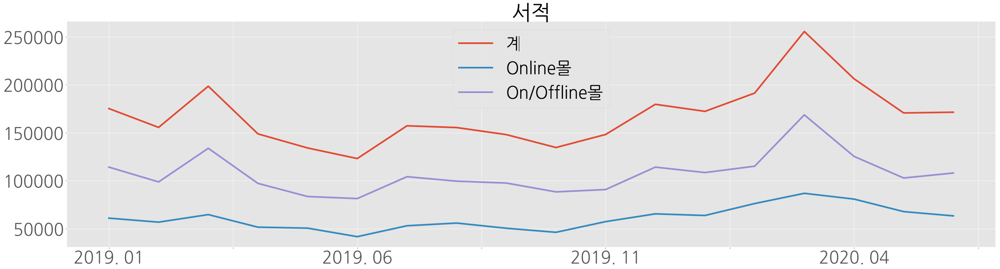

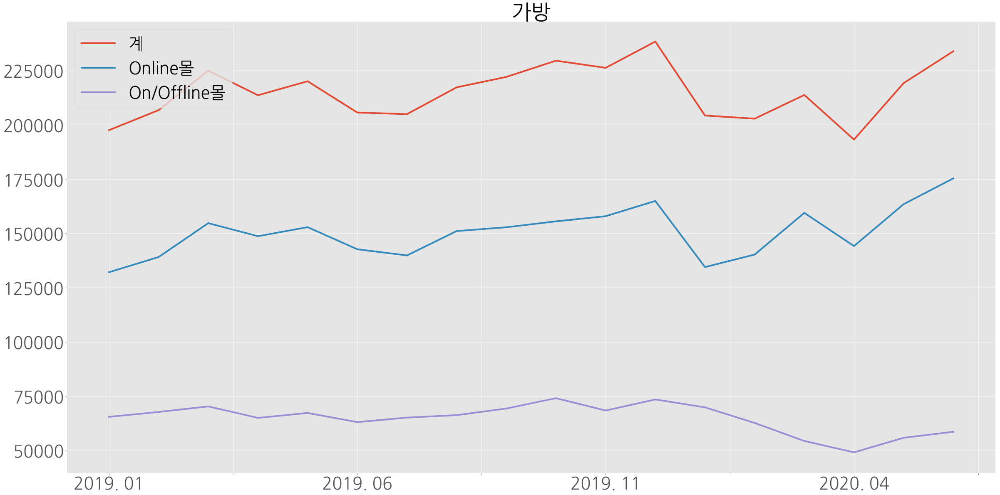

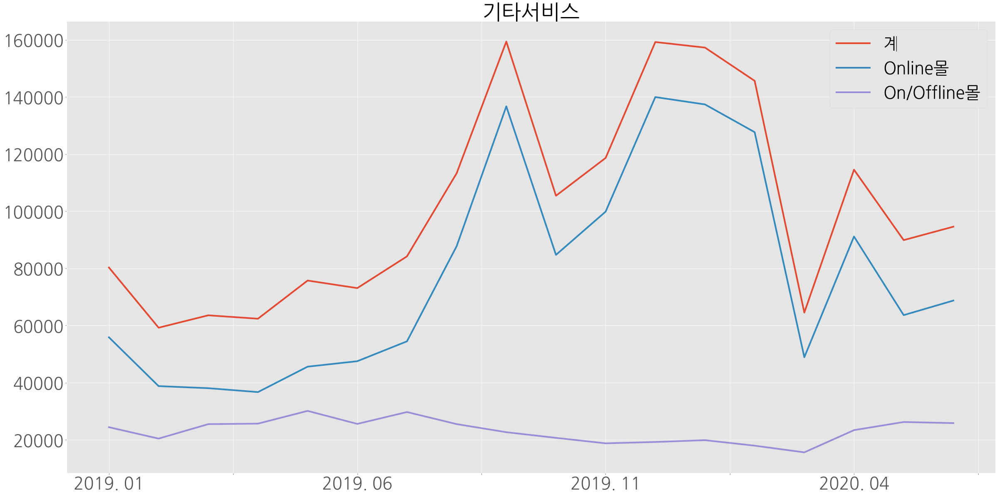

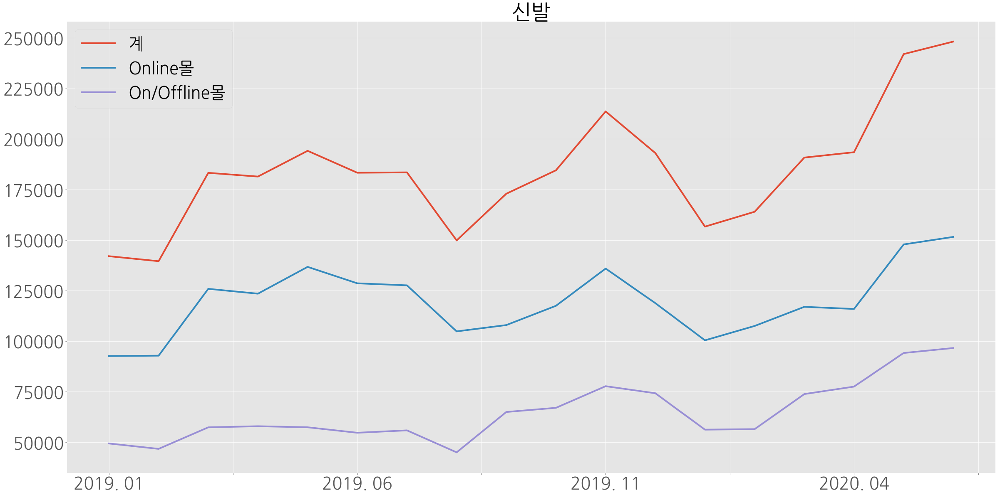

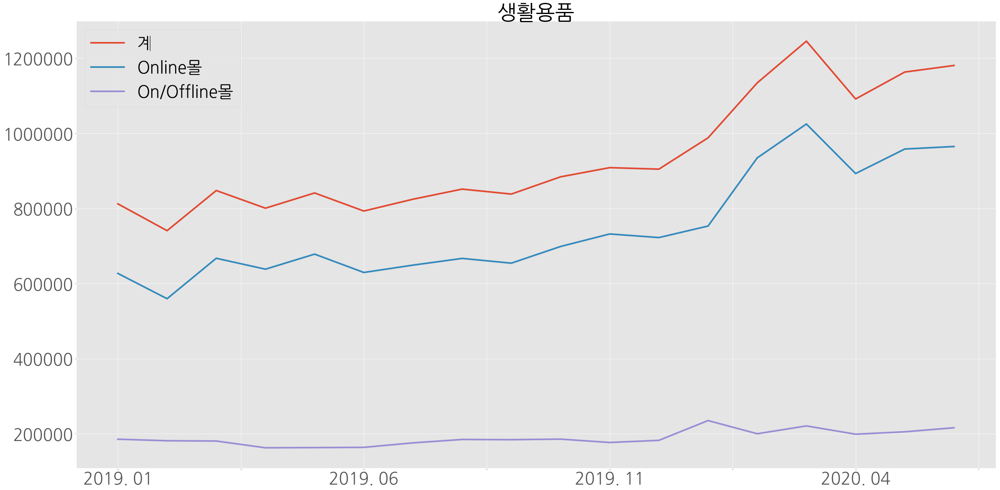

...

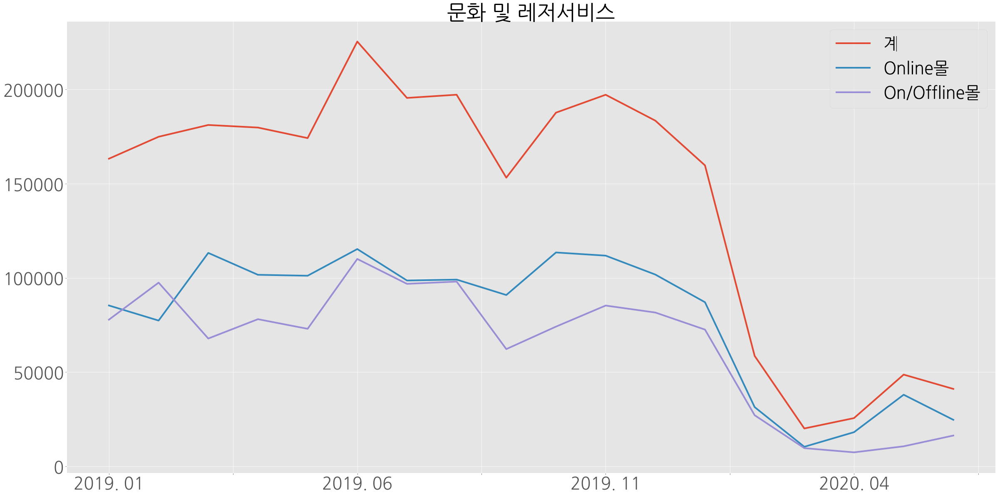

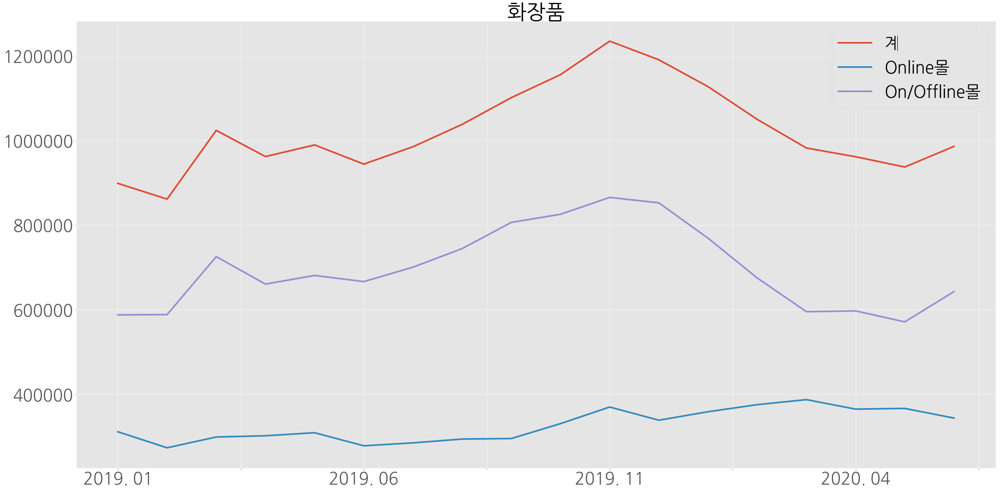

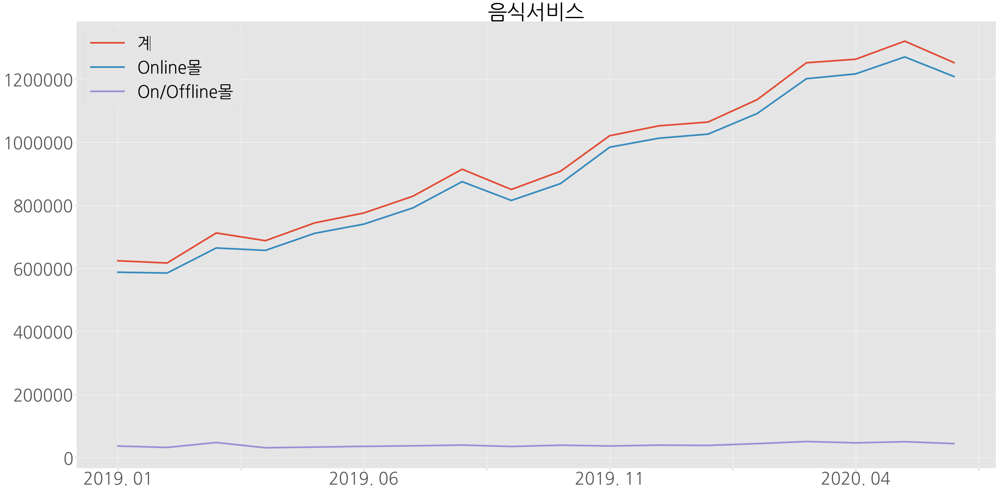

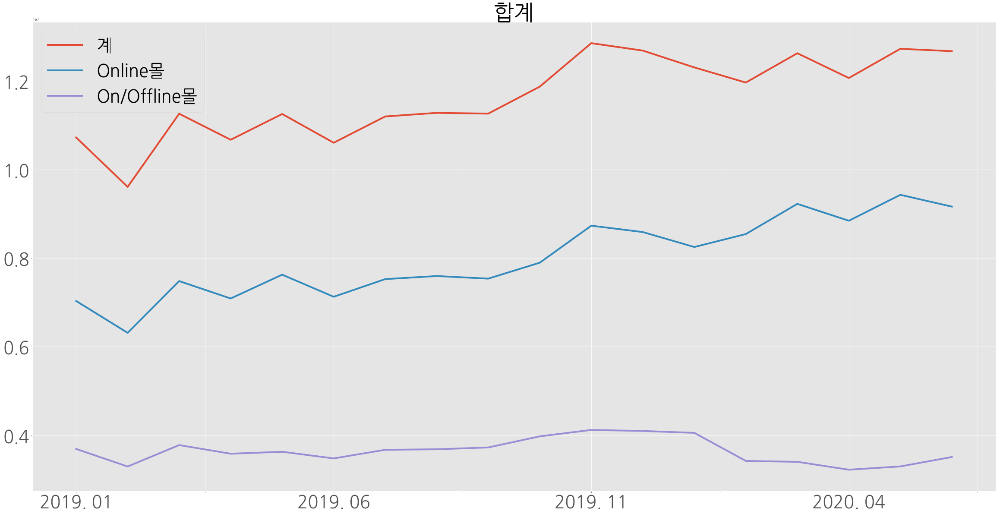

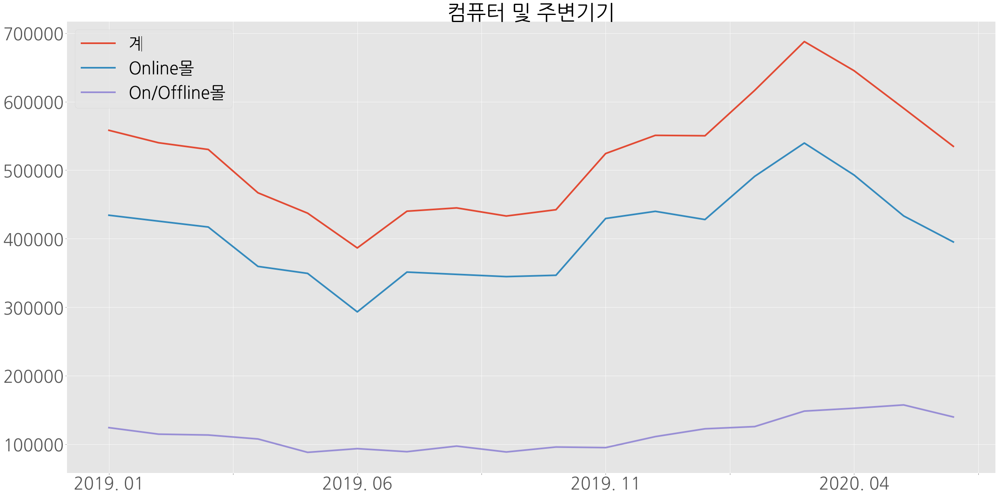

In [167]:
for index in online_shop_index:
    total = online_shop[online_shop.상품군별 == index].T.iloc[1:, :]
    total = total.rename(columns = total.iloc[0])
    total = total.drop(total.index[0])
    total.plot(linewidth = 4, markersize = 12)
    
    plt.rcParams["figure.figsize"] = (40,20)
    plt.title(f'{index}', fontsize = 50)
    plt.yticks(fontsize = 40)
    plt.xticks(fontsize = 40)
    plt.legend(fontsize = 40)
    plt.show()

In [173]:
gs_category.ANTC_ITEM_LCLS_NM.value_counts()

간식         60
홈&리빙       60
헬스&뷰티      60
식사         60
임신/육아      60
마실거리       60
사회활동       60
취미&여가활동    60
Name: ANTC_ITEM_LCLS_NM, dtype: int64